In [1]:
import seaborn as sns
import numpy as np
import pandas as pd
from matplotlib import pyplot
import matplotlib.pyplot as plt
import numpy as np

from itertools import product
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import scipy.cluster.hierarchy as hcluster
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN, KMeans

# Data Processing

In [3]:
# data=pd.read_csv("membrane_properties.csv")
data = pd.read_csv(
    "/home/l727r/Desktop/HEREON_2023_COMPUTING/Data/Membrane_Extraction_2023_03_08/membrane_properties.csv"
)
print(data.shape)
print(data.columns)

(1970, 48)
Index(['file_name', 'mesh__edges__count', 'mesh__edges__mean_length',
       'mesh__edges__std_length', 'mesh__triangles__mean_size',
       'mesh__triangles__std_size', 'mesh__triangles__mean_regularity',
       'mesh__triangles__std_regularity', 'all_pores__area__covered',
       'all_pores__instances__count', 'all_pores__instances__mean_size',
       'all_pores__instances__std_size', 'all_pores__instances__mean_diameter',
       'all_pores__instances__std_diameter',
       'all_pores__instances__mean_circularity',
       'all_pores__instances__std_circularity', 'open_pores__area__covered',
       'open_pores__instances__count', 'open_pores__instances__mean_size',
       'open_pores__instances__std_size',
       'open_pores__instances__mean_diameter',
       'open_pores__instances__std_diameter',
       'open_pores__instances__mean_circularity',
       'open_pores__instances__std_circularity', 'closed_pores__area__covered',
       'closed_pores__instances__count', 'closed_

In [4]:
# data=data.drop(columns=["covered_area__area__covered","covered_area__instances__count","covered_area__instances__mean_size","covered_area__instances__std_size"])
# data=data.drop(columns=["all_pores__area__covered","all_pores__instances__count","all_pores__instances__mean_size","all_pores__instances__std_size","all_pores__instances__mean_diameter","all_pores__instances__std_diameter","all_pores__instances__mean_circularity","all_pores__instances__std_circularity"])
# print(data.shape)
# print(data.columns)

In [5]:
def get_outliers(df, prop):
    q1 = df[prop].quantile(q=0.25)
    q3 = df[prop].quantile(q=0.75)
    iqr = q3 - q1
    upper = q3 + 1.5 * iqr
    lower = q1 - 1.5 * iqr

    out = df.loc[(df[prop] > upper) | (df[prop] < lower)]
    # out=out.loc[out[prop] < lower ]
    return out


def df_out_count(df):
    outliers = []
    for col in df.columns:
        if col in ["Unnamed: 0", "file_name"]:
            continue
        out = get_outliers(df, col)
        outliers += out["file_name"].values.tolist()

    un, cou = np.unique(outliers, return_counts=True)
    outliers_count = zip(cou, un)
    outliers_count = sorted(outliers_count, reverse=True)
    df["out_count"] = 0
    for x in outliers_count:
        df.loc[df["file_name"] == x[1], "out_count"] = [x[0]]
    return df


def df_norm_std(df):
    norm_df = df.copy()

    for col in norm_df.columns:
        if norm_df[col].dtype.kind in "iufc":
            norm_df[col] = (norm_df[col] - norm_df[col].mean()) / norm_df[col].std()
    return norm_df


def df_norm_01(df):
    norm_df = df.copy()

    for col in norm_df.columns:
        if norm_df[col].dtype.kind in "iufc":
            norm_df[col] = (norm_df[col] - norm_df[col].min()) / (
                norm_df[col].max() - norm_df[col].min()
            )
            # norm_data[col]=(norm_data[col]-norm_data[col].mean())/norm_data[col].std()
    return norm_df


def df_norm_std01(df):
    norm_df = df.copy()

    for col in norm_df.columns:
        if norm_df[col].dtype.kind in "iufc":
            norm_df[col] = (norm_df[col] - norm_df[col].mean()) / norm_df[col].std()
            norm_df[col] = (norm_df[col] - norm_df[col].min()) / (
                norm_df[col].max() - norm_df[col].min()
            )
            # norm_data[col]=(norm_data[col]-norm_data[col].mean())/norm_data[col].std()
    return norm_df


def df_to_np(df):
    df_np = np.array(df.values.tolist())[:, 1:]
    df_np = np.array(df_np, dtype=float)
    df_np = np.nan_to_num(df_np, nan=0)
    return df_np

In [6]:
data = df_out_count(data)
data_norm = df_norm_std(data)
data_norm_v2 = df_norm_01(data)
data_norm_v3 = df_norm_std01(data)

In [7]:
data_np = df_to_np(data)
out_count = df_to_np(data)[:, -1]
data_np = data_np[:, :-1]

data_norm_np = df_to_np(data_norm)[:, :-1]
data_norm_v2_np = df_to_np(data_norm_v2)[:, :-1]
data_norm_v3_np = df_to_np(data_norm_v3)[:, :-1]

In [45]:
def box_histo_plot_com(df, prop):
    # props=data.columns
    plot_titles = []
    # for p in props:
    #     plot_titles.append(p)
    #     plot_titles.append("")

    fig = make_subplots(
        rows=2,
        cols=1,
        shared_xaxes=True,
        vertical_spacing=0,
        column_titles=["Number of outlying Membrane Properties"],
        row_titles=["Number of Images", ""],
    )
    # cedeeb
    # 0059a0
    # e1462c
    # 5f3893
    fig.add_trace(go.Box(x=df[prop], name="", marker_color="#e1462c"), row=2, col=1)
    fig.add_trace(
        go.Histogram(histfunc="count", x=df[prop], marker_color="#0059a0"), row=1, col=1
    )
    # fig.update_yaxes(type="log",row=1,col=1)
    # fig.update_yaxes(range=[0,200],row=1,col=1)

    fig.update_layout(height=600, width=1800, showlegend=False, template="plotly_white",title_font=dict(size=20))

    for anno in fig["layout"]["annotations"]:
        anno["font"] = {"size": 18}
        if anno["textangle"]:
            anno["textangle"] = -90
            anno["x"] = -0.05
        # else:
        #     anno['y']=-0.1

    fig.update_xaxes(rangemode="tozero")
    fig.update_yaxes(rangemode="tozero")

    fig.update_xaxes(title_font=dict(size=20))
    fig.update_yaxes(title_font=dict(size=20))
    fig.update_xaxes(tickfont=dict(size=14))
    fig.update_yaxes(tickfont=dict(size=14))

    fig.show()
    return fig


# data_sel=data[data["out_count"]>7]
# print(len(data_sel))
f=box_histo_plot_com(data, "out_count")
pio.write_image(f, 'Outlier_Distrubution.png',scale=2)
# data_sel=data[data["out_count"]>4]
# fig = go.Figure(layout = dict(title='Outlier Count Distribution',width=1400, height=700, font=dict(size=18),xaxis=dict(title="Number Outliers"),yaxis=dict(title="Occurence"),template="plotly_white"))
# fig.add_trace(go.Histogram(histfunc="count", x=data_sel["out_count"],marker_color='#0059a0'))

# fig.show()

In [9]:
col_names=[]
out_counts=[]
for col in data.columns:
        if col in ["Unnamed: 0", "file_name","out_count"]:
            continue
        out = len(get_outliers(data, col))
        col_names.append(col)
        out_counts.append(out)
        #print(col,out)
combined_list = list(zip(out_counts, col_names))

# Sort the list of tuples based on the first element (i.e., list1)
sorted_list = sorted(combined_list, key=lambda x: x[0],reverse=True)

# Split the sorted list back into the original two lists
out_counts, col_names = zip(*sorted_list)
print(out_counts)
print(col_names)

(366, 316, 274, 260, 243, 239, 239, 205, 196, 179, 151, 150, 142, 140, 130, 112, 112, 111, 105, 103, 96, 92, 90, 83, 80, 73, 72, 52, 41, 37, 27, 27, 24, 21, 19, 19, 16, 16, 13, 11, 4, 2, 1, 0, 0, 0, 0)
('covered_area__area__covered', 'internal_structure__area__covered', 'covered_area__instances__count', 'mesh__triangles__std_size', 'internal_structure__instances__count', 'artifact_blob__area__covered', 'artifact_blob__instances__count', 'mesh__edges__std_length', 'closed_pores__area__covered', 'closed_pores__instances__count', 'all_pores__instances__mean_size', 'mesh__triangles__mean_size', 'mesh__edges__mean_length', 'open_pores__instances__mean_size', 'covered_area__instances__std_size', 'artifact_dust__area__covered', 'artifact_dust__instances__count', 'internal_structure__instances__std_size', 'open_pores__instances__mean_circularity', 'internal_structure__instances__mean_size', 'all_pores__instances__mean_circularity', 'open_pores__instances__std_diameter', 'covered_area__instance

In [15]:
import plotly.io as pio
#bar_trace = go.Bar(x=col_names, y=out_counts)

# Set up the figure
fig = go.Figure()

# Define the layout
fig.update_layout(title='<b>Number of Outliers per metric</b>', xaxis_title='Metric', yaxis_title='Number of Outliers', width=1800, height=600,template="plotly_white",title_font=dict(size=20))


# Add a bar trace to the figure
fig.add_trace(go.Bar(y=out_counts, x=col_names,marker_color="#0059a0"))
fig.update_xaxes(title_font=dict(size=20))
fig.update_yaxes(title_font=dict(size=20))

# Define the figure layout
#fig = go.Figure(data=[bar_trace], layout=go.Layout(title='My Bar Chart'))

# Display the figure
fig.show()
pio.write_image(fig, 'Outliers_per_metric.png',scale=2)

In [13]:

df = pd.DataFrame(out_counts, columns=["C"])
get_outliers(df,"C")

,C
0,366


In [29]:
files

,file_name,mesh__edges__count,mesh__edges__mean_length,mesh__edges__std_length,mesh__triangles__mean_size,mesh__triangles__std_size,mesh__triangles__mean_regularity,mesh__triangles__std_regularity,all_pores__area__covered,all_pores__instances__count,...,internal_structure__instances__std_size,artifact_blob__area__covered,artifact_blob__instances__count,artifact_blob__instances__mean_size,artifact_blob__instances__std_size,artifact_dust__area__covered,artifact_dust__instances__count,artifact_dust__instances__mean_size,artifact_dust__instances__std_size,out_count
1,S16046_112a_PS83-P4VP17-88k_OS_002.png,8,814.603709,274.575082,170400.925926,126936.712297,0.456518,0.280228,58.971050,5,...,NaN,2232.098765,5,90.4,142.523823,0.000000,0,NaN,NaN,11
3,S16244_26%_PS75P4VP25_100k_13s_50DMF_50THF_003...,2162,71.338964,46.417328,2244.367732,3307.145341,0.716088,0.186436,497220.302508,757,...,691.800257,0.000000,0,NaN,NaN,0.000000,0,NaN,NaN,9
15,S17014_PS75P4VP25_100k_15s_50DMF_50THF_006.png,406,165.039345,131.009953,10070.769774,12645.776767,0.474116,0.197927,378181.341618,147,...,5247.704151,0.000000,0,NaN,NaN,0.000000,0,NaN,NaN,16
16,S17014_PS75P4VP25_100k_15s_50DMF_50THF_007.png,272,194.130385,113.285672,13462.635601,12267.606209,0.495837,0.206329,268902.089450,110,...,5020.968582,0.000000,0,NaN,NaN,0.000000,0,NaN,NaN,15
17,S17014_PS75P4VP25_100k_15s_50DMF_50THF_008.png,477,159.408937,111.235468,9324.595794,12494.238216,0.472616,0.184942,408492.461155,173,...,3721.185410,0.000000,0,NaN,NaN,0.000000,0,NaN,NaN,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1920,S22099_19% PS78-b-P4VP22_192kDa_DMF_THF-60_40_...,60,526.607568,304.815152,70493.561270,42205.286440,0.533684,0.209446,29420.656687,24,...,492.976415,0.000000,0,NaN,NaN,0.000000,0,NaN,NaN,14
1921,S22099_19% PS78-b-P4VP22_192kDa_DMF_THF-60_40_...,99,368.651580,196.714682,41200.938351,30930.076086,0.506894,0.198371,32398.694696,38,...,496.007066,0.000000,0,NaN,NaN,0.000000,0,NaN,NaN,14
1935,S23005_P4VP18-b-PS82_135kDa_40_20_40_20wt%_15s...,1436,91.578314,33.079454,3317.238089,2001.157985,0.644708,0.166278,452820.999202,511,...,102.287642,13723.456790,5,555.8,232.521311,1451.851852,2,147.000000,135.000000,8
1948,S23005_P4VP18-b-PS82_135kDa_50_30_20_23wt%_15s...,960,110.152556,41.854358,4805.581085,3153.260133,0.620142,0.161557,410355.946325,346,...,128.415727,0.000000,0,NaN,NaN,553.086420,1,112.000000,0.000000,8


In [30]:
file_name

('S17155_PS75P4VP25_100k_25%_25s_40DMF_60THF_002.png',
 'S19132_PS88P4VP18_150k_28%-D_T; 1500_20s_007.png',
 'S17078_PS75P4VP25_100k_25s_50DMF_50THF_005.png',
 'S18049_PS78P4VP22_98k_26%_23s_003.png',
 'S18049_PS78P4VP22_98k_26%_23s_004.png',
 'S20133_PS76P4VP24_98k_25wt%_15s_003.png',
 'S20133_PS76P4VP24_98k_26wt%_20s_001.png',
 'S17014_PS75P4VP25_100k_15s_50DMF_50THF_009.png',
 'S17155_PS75P4VP25_100k_20%_25s_50DMF_50THF_004.png',
 'S17155_PS75P4VP25_100k_27%_15s_50DMF_50THF_002.png',
 'S20133_PS76P4VP24_98k_24wt%_10s_010.png',
 'S20133_PS76P4VP24_98k_26wt%_20s_003.png',
 'S17107_PS75P4VP25_100k_10s_50DMF_50THF_002.png',
 'S17204_PS75P4VP25_100k_5s_0kV_15s_50DMF_50THF_002.png',
 'S18021_PS75P4VP25_100k_13s_001.png',
 'S19074_PS76P4VP24_98k_28wt%_0kV_15s_013.png',
 'S19131_PS88P4VP18_150k_18%-D_T; 4500_20s_007.png',
 'S20132_PS80P4VP20_182k_24wt%__35s_001.png',
 'S20133_PS76P4VP24_98k_24wt%_30s_001.png',
 'S20133_PS76P4VP24_98k_26wt%_30s_001.png',
 'S22099_17% PS78-b-P4VP22_192kDa_DMF

In [50]:
from PIL import Image
from os.path import join
#files = data[data["out_count"] > 7]
#files = data[data["out_count"] < 7]
files = data[data["out_count"] > 6]
grid_i=6
grid_j=8
#data_out = zip(files["out_count"], files["file_name"])
#out_count,file_name=sorted(data_out, reverse=True)


combined_list = list(zip(files["out_count"], files["file_name"]))

# Sort the list of tuples based on the first element (i.e., list1)
#sorted_list = sorted(combined_list, key=lambda x: x[0],reverse=True)
sorted_list = sorted(combined_list, key=lambda x: x[0],reverse=False)

# Split the sorted list back into the original two lists
out_counts, file_name = zip(*sorted_list)


root = "/home/l727r/Desktop/HEREON_2023_COMPUTING/Data/Membrane_Extraction_2023_03_08/"
name="outliers"

def get_concat_h(im1, im2):
    dst = Image.new("RGB", (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst


def get_concat_v(im1, im2):
    dst = Image.new("RGB", (im1.width, im1.height + im2.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (0, im1.height))
    return dst

for i in range(0,grid_i):
    for j in range(0,grid_j):
        idx=i*grid_j+j
        file=file_name[idx]
        print(f"{idx}:   {file}")
        img = Image.open(join(root, "images", file))
        mask = Image.open(join(root, "Visualization__Classes", file))
        if j == 0:
            fig_row = img
            mask_row = mask
        else:
            fig_row = get_concat_h(fig_row, img)
            mask_row = get_concat_h(mask_row, mask)

    if i == 0:
        fig = fig_row
        fig_mask = mask_row
    else:
        fig = get_concat_v(fig, fig_row)
        fig_mask = get_concat_v(fig_mask, mask_row)
fig.save(name + "_image.png")
fig_mask.save(name + "_mask.png")


0:   S17136_PS75P4VP25_100k_40s_100DOX_002.png
1:   S17233_30%GM125_D_T_3000_7s_001.png
2:   S17233_30%GM125_D_T_3000_7s_004.png
3:   S17245_PS84P4VP16_210k_28%_DMF-THF_60-40_10s_007.png
4:   S17267_PS81P4VP19-154k_26.5%_DMF60-THF40_G_2s_003.png
5:   S18136_PVBCB83-P4VP17_185k_15s_002.png
6:   S18143_PVBCB83P4VP17_185K-10s_sol-c_003.png
7:   S18162_PVBCB81P4VP19-210K-10s_solb_002.png
8:   S18162_PVBCB81P4VP19-210K-5s_solb_002.png
9:   S19050_PS76P4VP26_166k_19%_THF_DMF_DOX_3_4_3_G10s_003.png
10:   S19059_PS88P4VP18_150k_24%-DMF; 4500_10s_006.png
11:   S19077_PS76P4VP24_238k_19 wt%_THF_DMF_5_5_G10s_002.png
12:   S19090_SVP20_182k_24 wt%_THF_DMF_4_6_G15s_001.png
13:   S19098_P(S-VBCB)84P4VP16-126K-10s-200um_002.png
14:   S19098_PVBCB79P4VP21-240K-5s-100um_003.png
15:   S19106_P(S-VBCB)84P4VP16-240K(18)-10s-200um_002.png
16:   S19120_PS88P4VP18_150k_24%-7D_3T; 1500_5s_003.png
17:   S19122_PS88P4VP18_150k_17%-D_T; RT_10s_002.png
18:   S20038_PVBCB79P4VP21-86K-2cm-15min-180°C_002.png
19:   

In [51]:
out_counts[47]

8

In [ ]:
# img_path="F:\Desktop\HEREON_2023_COMPUTING\Data\Membrane_Extraction_2023_03_08\images"
root = "/home/l727r/Desktop/HEREON_2023_COMPUTING/Data/Membrane_Extraction_2023_03_08/"
import shutil
import glob
from os.path import join
import os


def copy_files(df, cluster, name=None, n=6):
    # os.makedirs(name,exist_ok=True)
    data_x = df.copy()
    data_x["cluster"] = cluster.labels_
    c_numb = np.unique(data_x["cluster"])

    for cid in c_numb:
        files = data_x[data_x["cluster"] == cid]
        files = files["file_name"]
        if len(files) >= n:
            replace = False
        else:
            replace = True
        files = np.random.choice(files, n, replace)

        for i, file in enumerate(files):
            img = Image.open(join(root, "images", file))
            mask = Image.open(join(root, "Visualization__Classes", file))
            if i == 0:
                fig_row = img
                mask_row = mask
            else:
                fig_row = get_concat_h(fig_row, img)
                mask_row = get_concat_h(mask_row, mask)
        if cid == 0:
            fig = fig_row
            fig_mask = mask_row
        else:
            fig = get_concat_v(fig, fig_row)
            fig_mask = get_concat_v(fig_mask, mask_row)
    fig.save(name + "_image.png")
    fig_mask.save(name + "_mask.png")
    # out_name=f"cluster_{cid}__{i}_{file}"
    # shutil.copy(join(img_path,file),join(name,out_name))

# TSNE

In [12]:
def add_scatter_1d(d1d, color=None, colorscale="Viridis"):
    n, c = d1d.shape
    return go.Scatter(
        x=d1d[:, 0],
        y=[0] * n,
        mode="markers",
        hovertext=color,
        marker=dict(
            opacity=0.5, cmin=0, cmax=np.max(color), color=color, colorscale=colorscale
        ),
    )


def add_scatter_2d(d2d, color=None, colorscale="Viridis"):
    return go.Scatter(
        x=d2d[:, 0],
        y=d2d[:, 1],
        mode="markers",
        hovertext=color,
        marker=dict(
            opacity=0.5, cmin=0, cmax=np.max(color), color=color, colorscale=colorscale
        ),
    )  # hover text goes here


def add_scatter_3d(d3d, color=None, colorscale="Viridis"):
    return go.Scatter3d(
        x=d3d[:, 0],
        y=d3d[:, 1],
        z=d3d[:, 2],
        hovertext=color,
        mode="markers",
        marker=dict(
            size=3,
            opacity=0.5,
            cmin=0,
            cmax=np.max(color),
            color=color,
            colorscale=colorscale,
        ),
    )


def plot_data(p2d, p3d, t2d, t3d, color=None, disc=False):
    fig = make_subplots(
        rows=1,
        cols=4,
        specs=[
            [
                {"type": "Scatter"},
                {"type": "Scatter3d"},
                {"type": "Scatter"},
                {"type": "Scatter3d"},
            ]
        ],
        subplot_titles=("PCA 2D", "PCA 3D", "t-SNE 2D", "t-SNE 3D"),
    )
    # fig = make_subplots(rows=1, cols=4,specs=[[{"type": "Scatter"}, {"type": "Scatter3d"},{"type": "Scatter"}, {"type": "Scatter3d"}]],subplot_titles=("PCa 2D", "PCA 3D", "TSNE 2D", "TSNE 3D"))

    fig.update_layout(height=800, width=3200, showlegend=False, template="plotly_white")
    colorscale = "Turbo" if disc else "Viridis"
    # # PCA
    n, c = p2d.shape
    if c == 2:
        fig.add_trace(add_scatter_2d(p2d, color, colorscale), row=1, col=1)
    elif c == 1:
        fig.add_trace(add_scatter_1d(p2d, color, colorscale), row=1, col=1)
    fig.add_trace(add_scatter_3d(p3d, color, colorscale), row=1, col=2)

    # TSNE
    n, c = t2d.shape
    if c == 2:
        fig.add_trace(add_scatter_2d(t2d, color, colorscale), row=1, col=3)
    elif c == 1:
        fig.add_trace(add_scatter_1d(t2d, color, colorscale), row=1, col=3)
    fig.add_trace(add_scatter_3d(t3d, color, colorscale), row=1, col=4)

    fig.show()

In [17]:
from PIL import Image


def get_concat_h(im1, im2):
    dst = Image.new("RGB", (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst


def get_concat_v(im1, im2):
    dst = Image.new("RGB", (im1.width, im1.height + im2.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (0, im1.height))
    return dst


# img_path="F:\Desktop\HEREON_2023_COMPUTING\Data\Membrane_Extraction_2023_03_08\images"
root = "/home/l727r/Desktop/HEREON_2023_COMPUTING/Data/Membrane_Extraction_2023_03_08/"
import shutil
import glob
from os.path import join
import os


def copy_files(df, cluster, name=None, n=6):
    # os.makedirs(name,exist_ok=True)
    data_x = df.copy()
    data_x["cluster"] = cluster.labels_
    c_numb = np.unique(data_x["cluster"])

    for cid in c_numb:
        files = data_x[data_x["cluster"] == cid]
        files = files["file_name"]
        if len(files) >= n:
            replace = False
        else:
            replace = True
        files = np.random.choice(files, n, replace)

        for i, file in enumerate(files):
            img = Image.open(join(root, "images", file))
            mask = Image.open(join(root, "Visualization__Classes", file))
            if i == 0:
                fig_row = img
                mask_row = mask
            else:
                fig_row = get_concat_h(fig_row, img)
                mask_row = get_concat_h(mask_row, mask)
        if cid == 0:
            fig = fig_row
            fig_mask = mask_row
        else:
            fig = get_concat_v(fig, fig_row)
            fig_mask = get_concat_v(fig_mask, mask_row)
    fig.save(name + "_image.png")
    fig_mask.save(name + "_mask.png")
    # out_name=f"cluster_{cid}__{i}_{file}"
    # shutil.copy(join(img_path,file),join(name,out_name))

# Org Data

In [144]:
pca_2d = PCA(n_components=2).fit_transform(data_np)
pca_3d = PCA(n_components=3).fit_transform(data_np)

In [146]:
tsne_2d = TSNE(
    n_components=2, learning_rate="auto", init="random", perplexity=150
).fit_transform(data_np)
tsne_3d = TSNE(
    n_components=3, learning_rate="auto", init="random", perplexity=150
).fit_transform(data_np)

In [ ]:
cl_hd = KMeans(n_clusters=10, n_init="auto").fit(data_np)
print("HD")
val, cou = np.unique(cl_hd.labels_, return_counts=True)
for v, c in zip(val, cou):
    print(f"clsuter {v} has size {c}")

c1_ts = KMeans(n_clusters=10, n_init="auto").fit(tsne_2d)
print("LD")
val, cou = np.unique(c1_ts.labels_, return_counts=True)
for v, c in zip(val, cou):
    print(f"clsuter {v} has size {c}")

In [147]:
copy_files(data, cl_hd, "Base_selection_hd", 6)
# copy_files(data,c1_ts,"Base_selection_ts",6)

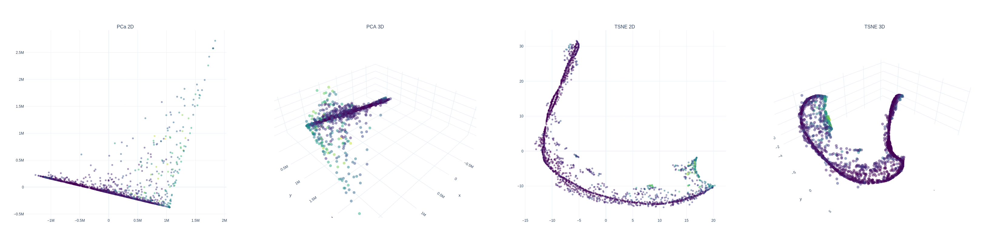

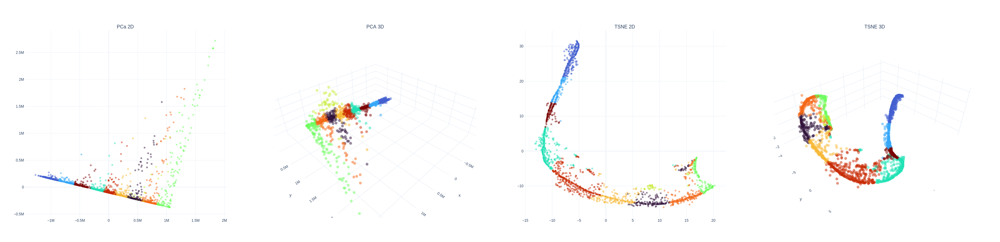

In [148]:
plot_data(pca_2d, pca_3d, tsne_2d, tsne_3d, out_count, False)
plot_data(pca_2d, pca_3d, tsne_2d, tsne_3d, cl_hd.labels_, True)
# plot_data(pca_2d,pca_3d,tsne_2d,tsne_3d,c1_ts.labels_,True)

# Data norm std

In [149]:
pca_2d_norm = PCA(n_components=2).fit_transform(data_norm_np)
pca_3d_norm = PCA(n_components=3).fit_transform(data_norm_np)

In [150]:
tsne_2d_norm = TSNE(
    n_components=2, learning_rate="auto", init="random", perplexity=150
).fit_transform(data_norm_np)
tsne_3d_norm = TSNE(
    n_components=3, learning_rate="auto", init="random", perplexity=150
).fit_transform(data_norm_np)

In [151]:
cl_hd_norm = KMeans(n_clusters=10, n_init="auto").fit(data_norm_np)
print("HD")
val, cou = np.unique(cl_hd_norm.labels_, return_counts=True)
for v, c in zip(val, cou):
    print(f"clsuter {v} has size {c}")

c1_ts_norm = KMeans(n_clusters=10, n_init="auto").fit(tsne_2d_norm)
print("LD")
val, cou = np.unique(c1_ts_norm.labels_, return_counts=True)
for v, c in zip(val, cou):
    print(f"clsuter {v} has size {c}")

HD
clsuter 0 has size 425
clsuter 1 has size 109
clsuter 2 has size 108
clsuter 3 has size 323
clsuter 4 has size 47
clsuter 5 has size 429
clsuter 6 has size 2
clsuter 7 has size 21
clsuter 8 has size 272
clsuter 9 has size 234
LD
clsuter 0 has size 176
clsuter 1 has size 194
clsuter 2 has size 198
clsuter 3 has size 268
clsuter 4 has size 129
clsuter 5 has size 240
clsuter 6 has size 134
clsuter 7 has size 244
clsuter 8 has size 219
clsuter 9 has size 168


In [152]:
copy_files(data, cl_hd_norm, "Norm_hd", 6)
# copy_files(data,c1_ts_norm,"Norm_ts",6)

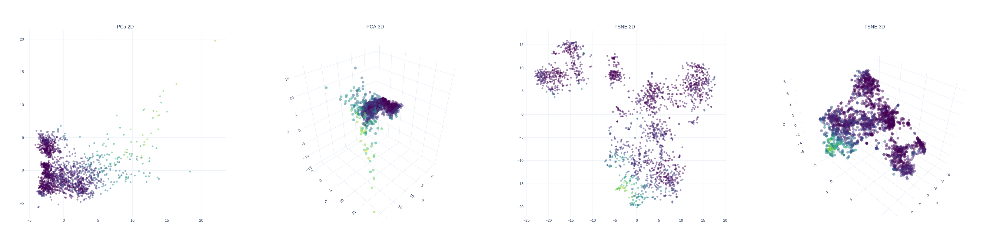

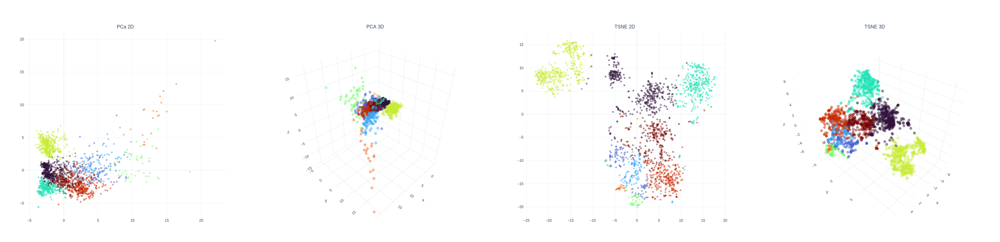

In [153]:
plot_data(pca_2d_norm, pca_3d_norm, tsne_2d_norm, tsne_3d_norm, out_count)
plot_data(
    pca_2d_norm, pca_3d_norm, tsne_2d_norm, tsne_3d_norm, cl_hd_norm.labels_, True
)
# plot_data(pca_2d_norm,pca_3d_norm,tsne_2d_norm,tsne_3d_norm,c1_ts_norm.labels_,True)

# Data norm  01

In [14]:
pca_2d_norm2 = PCA(n_components=2).fit_transform(data_norm_v2_np)
pca_3d_norm2 = PCA(n_components=3).fit_transform(data_norm_v2_np)

In [15]:
tsne_2d_norm2 = TSNE(
    n_components=2, learning_rate="auto", init="pca", perplexity=150
).fit_transform(data_norm_v2_np)
tsne_3d_norm2 = TSNE(
    n_components=3, learning_rate="auto", init="pca", perplexity=150
).fit_transform(data_norm_v2_np)

In [16]:
cl_hd_normv2 = KMeans(n_clusters=10, n_init="auto").fit(data_norm_v2_np)
print("HD")
val, cou = np.unique(cl_hd_normv2.labels_, return_counts=True)
for v, c in zip(val, cou):
    print(f"cluster {v} has size {c}")

c1_ts_normv2 = KMeans(n_clusters=10, n_init="auto").fit(tsne_2d_norm2)
print("LD")
val, cou = np.unique(c1_ts_normv2.labels_, return_counts=True)
for v, c in zip(val, cou):
    print(f"cluster {v} has size {c}")

HD
cluster 0 has size 266
cluster 1 has size 325
cluster 2 has size 114
cluster 3 has size 48
cluster 4 has size 302
cluster 5 has size 159
cluster 6 has size 56
cluster 7 has size 318
cluster 8 has size 289
cluster 9 has size 93
LD
cluster 0 has size 227
cluster 1 has size 160
cluster 2 has size 247
cluster 3 has size 261
cluster 4 has size 175
cluster 5 has size 218
cluster 6 has size 174
cluster 7 has size 231
cluster 8 has size 117
cluster 9 has size 160


In [17]:
copy_files(data, cl_hd_normv2, "Normv2_hd", 6)
# copy_files(data,c1_ts_normv2,"Normv2_ts",6)

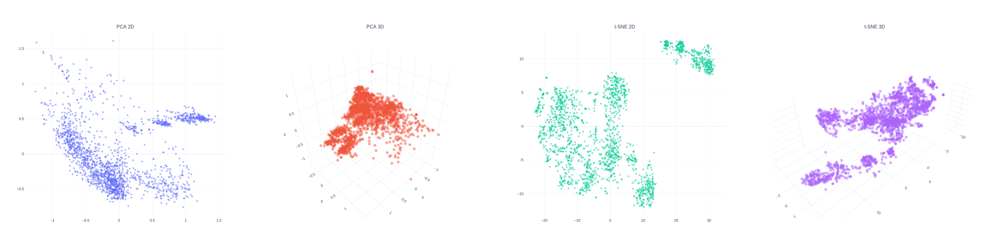

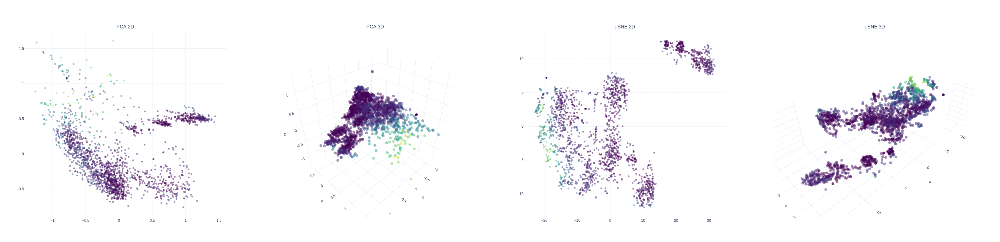

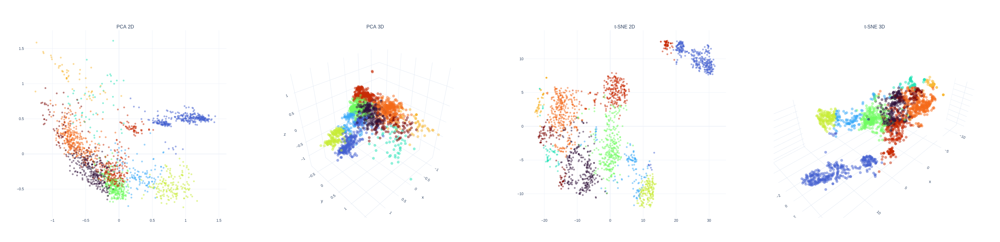

In [18]:
# pca_3d_tsne = PCA(n_components=3).fit_transform(tsne_3d_norm2)


plot_data(pca_2d_norm2, pca_3d_norm2, tsne_2d_norm2, tsne_3d_norm2)
plot_data(pca_2d_norm2, pca_3d_norm2, tsne_2d_norm2, tsne_3d_norm2, out_count)
plot_data(
    pca_2d_norm2, pca_3d_norm2, tsne_2d_norm2, tsne_3d_norm2, cl_hd_normv2.labels_, True
)

# v3

In [182]:
pca_2d_norm3 = PCA(n_components=2).fit_transform(data_norm_v3_np)
pca_3d_norm3 = PCA(n_components=3).fit_transform(data_norm_v3_np)

In [183]:
tsne_2d_norm3 = TSNE(
    n_components=2, learning_rate="auto", init="random", perplexity=150
).fit_transform(data_norm_v3_np)
tsne_3d_norm3 = TSNE(
    n_components=3, learning_rate="auto", init="random", perplexity=150
).fit_transform(data_norm_v3_np)

In [184]:
cl_hd_normv3 = KMeans(n_clusters=10, n_init="auto").fit(data_norm_v3_np)
print("HD")
val, cou = np.unique(cl_hd_normv3.labels_, return_counts=True)
for v, c in zip(val, cou):
    print(f"clsuter {v} has size {c}")

c1_ts_normv3 = KMeans(n_clusters=10, n_init="auto").fit(tsne_2d_norm3)
print("LD")
val, cou = np.unique(c1_ts_normv3.labels_, return_counts=True)
for v, c in zip(val, cou):
    print(f"clsuter {v} has size {c}")

HD
clsuter 0 has size 223
clsuter 1 has size 275
clsuter 2 has size 136
clsuter 3 has size 105
clsuter 4 has size 197
clsuter 5 has size 298
clsuter 6 has size 332
clsuter 7 has size 218
clsuter 8 has size 78
clsuter 9 has size 108
LD
clsuter 0 has size 131
clsuter 1 has size 160
clsuter 2 has size 265
clsuter 3 has size 228
clsuter 4 has size 190
clsuter 5 has size 213
clsuter 6 has size 218
clsuter 7 has size 140
clsuter 8 has size 168
clsuter 9 has size 257


In [186]:
copy_files(data, cl_hd_normv3, "Normv3_hd", 6)
# copy_files(data,c1_ts_normv3,"Normv3_ts",6)

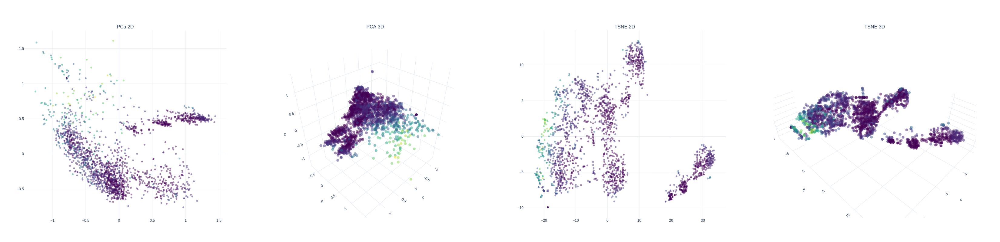

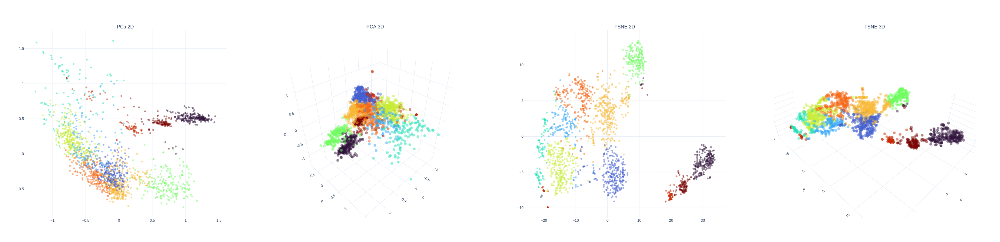

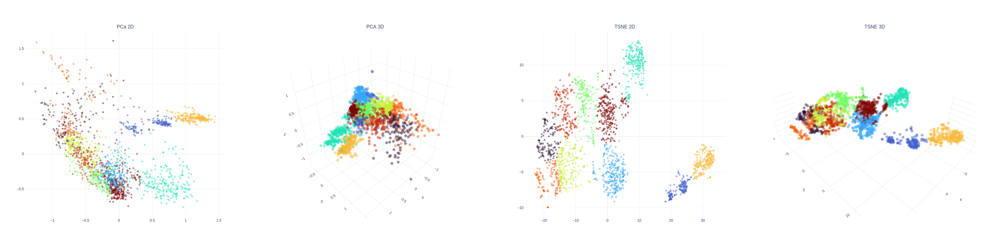

In [185]:
plot_data(pca_2d_norm3, pca_3d_norm3, tsne_2d_norm3, tsne_3d_norm3, out_count)
plot_data(
    pca_2d_norm3, pca_3d_norm3, tsne_2d_norm3, tsne_3d_norm3, cl_hd_normv3.labels_, True
)
# plot_data(pca_2d_norm2,pca_3d_norm2,tsne_2d_norm2,tsne_3d_norm2,cl_hd_normv2,True)
plot_data(
    pca_2d_norm3, pca_3d_norm3, tsne_2d_norm3, tsne_3d_norm3, c1_ts_normv3.labels_, True
)
# plot_data(pca_2d_norm2,pca_3d_norm2,tsne_2d_norm2,tsne_3d_norm2,c1_ts_normv2,True)

In [86]:
img_path = "F:\Desktop\HEREON_2023_COMPUTING\Data\Membrane_Extraction_2023_03_08\images"
import shutil
import glob
from os.path import join


def copy_files(df, cluster, name=None, n=6):
    os.makedirs(name, exist_ok=True)
    data_x = df.copy()
    data_x["cluster"] = cluster.labels_
    c_numb = np.unique(data_x["cluster"])

    for cid in c_numb:
        files = data_x[data_x["cluster"] == cid]
        files = files["file_name"]
        files = np.random.choice(files, n)

        for i, file in enumerate(files):
            out_name = f"cluster_{cid}__{i}_{file}"
            shutil.copy(join(img_path, file), join(name, out_name))


copy_files(data, c1_ts_normv2, "Test", 6)
# import glob
# from os.path import join
# img_path="F:\Desktop\HEREON_2023_COMPUTING\Data\Membrane_Extraction_2023_03_08\images"
# files=glob.glob(join(img_path,"*.png"))
# len(files)

In [301]:
tsne_1d = TSNE(
    n_components=1, learning_rate="auto", init="random", perplexity=150
).fit_transform(data_norm_np[:, :-1])
tsne_2d = TSNE(
    n_components=2, learning_rate="auto", init="random", perplexity=150
).fit_transform(data_norm_np[:, :-1])
tsne_3d = TSNE(
    n_components=3, learning_rate="auto", init="random", perplexity=150
).fit_transform(data_norm_np[:, :-1])

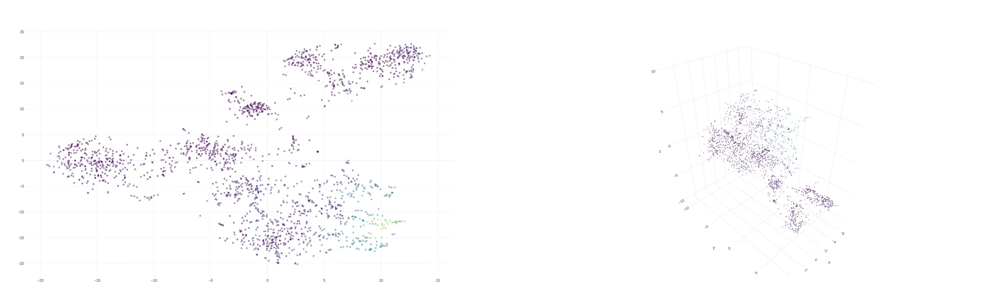

In [303]:
plot_tsne(tsne_2d, tsne_3d, data_np[:, -1])

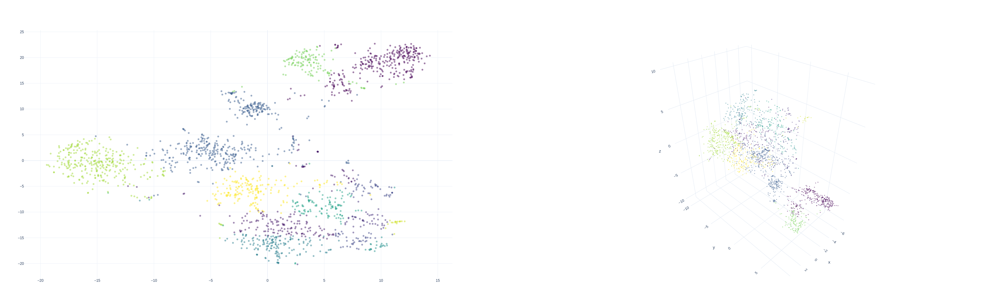

In [309]:
# db_2d = KMeans(n_clusters=15).fit(tsne_2d)
plot_tsne(tsne_2d, tsne_3d, db_2d.labels_)

In [305]:
db_2d = KMeans(n_clusters=15).fit(data_norm_np)

/home/l727r/anaconda3/envs/data_viz/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [306]:
vl, cn = np.unique(db_2d.labels_, return_counts=True)
for vc in zip(vl, cn):
    print(vc)

(0, 302)
(1, 177)
(2, 45)
(3, 84)
(4, 416)
(5, 2)
(6, 158)
(7, 23)
(8, 114)
(9, 1)
(10, 1)
(11, 132)
(12, 317)
(13, 17)
(14, 181)


In [308]:
data_x = data.copy()
cid = 7
data_x["cluster"] = db_2d.labels_
files = data_x[data_x["cluster"] == cid]
for f in files["file_name"]:
    print(f"'{f}',")

'S16046_112a_PS83-P4VP17-88k_OS_002.png',
'S17078_PS83,6P4VP16,8_198k_30s_50DMF_50THF_002.png',
'S17107_PS83,2P4VP16,8_113k_5s_50DMF_50THF_001.png',
'S17155_PS75P4VP25_100k_20%_15s_50DMF_50THF_002.png',
'S17233_25%GM125_D_T_3000_5s_004.png',
'S18032_PS81P4VP19_170k_22%_D_T_6000_30s_001.png',
'S18136_PVBCB83-P4VP17_185k_15s_002.png',
'S18161_PS81.8P4VP18.2_188k_25%_THF_DMF_4_6_G10s_001.png',
'S18161_PS81.8P4VP18.2_188k_25%_THF_DMF_4_6_G15s_001.png',
'S18161_PS81.8P4VP18.2_188k_25%_THF_DMF_4_6_G5s_001.png',
'S19050_PS74P4VP26_166k_22%_THF_DMF_4_6_S10s_005.png',
'S19050_PS82P4VP18_191k_22%_THF_DMF_35_65_S10s_002.png',
'S19090_SVP20_182k_24 wt%_THF_DMF_4_6_G15s_001.png',
'S19090_SVP20_182k_25 wt%_THF_DMF_4_6_G15s_001.png',
'S20057_P(VBCB-co-S)81P4VP19-159K-5s-100um-22wt%_007.png',
'S20132_PS80P4VP20_182k_23wt%_15s_001.png',
'S20132_PS80P4VP20_182k_23wt%_20s_001.png',
'S20132_PS80P4VP20_182k_24wt%_20s_001.png',
'S20132_PS80P4VP20_182k_24wt%__35s_001.png',
'S20133_PS76P4VP24_98k_24wt%_15s_01

In [194]:
col = np.where(data_np[:, -1] > 5, 1, 0)
plot_tsne(tsne_2d, tsne_3d, col)

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

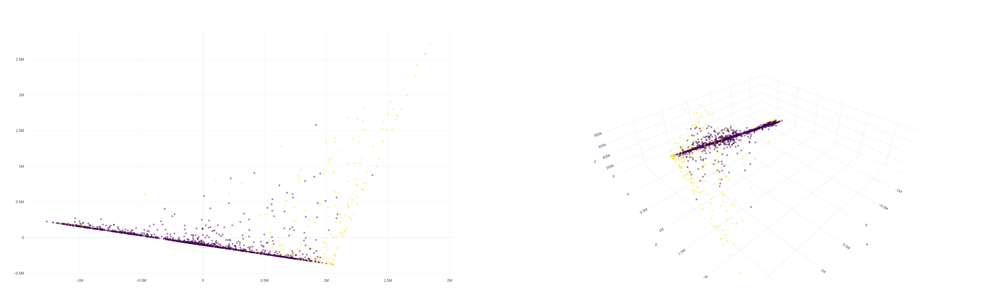

In [112]:
col = np.where(data_np[:, -1] > 5, 1, 0)
plot_tsne(pca_2d, pca_3d, col)

In [ ]:
files = data[data["out_count"] > 10]
print(len(files))
for f in files["file_name"]:
    print(f"'{f}',")

# Select DC

In [159]:
data.columns

Index(['file_name', 'mesh__edges__count', 'mesh__edges__mean_length',
       'mesh__edges__std_length', 'mesh__triangles__mean_size',
       'mesh__triangles__std_size', 'mesh__triangles__mean_regularity',
       'mesh__triangles__std_regularity', 'all_pores__area__covered',
       'all_pores__instances__count', 'all_pores__instances__mean_size',
       'all_pores__instances__std_size', 'all_pores__instances__mean_diameter',
       'all_pores__instances__std_diameter',
       'all_pores__instances__mean_circularity',
       'all_pores__instances__std_circularity', 'open_pores__area__covered',
       'open_pores__instances__count', 'open_pores__instances__mean_size',
       'open_pores__instances__std_size',
       'open_pores__instances__mean_diameter',
       'open_pores__instances__std_diameter',
       'open_pores__instances__mean_circularity',
       'open_pores__instances__std_circularity', 'closed_pores__area__covered',
       'closed_pores__instances__count', 'closed_pores__inst

In [160]:
norm_data.shape

(1970, 48)

In [161]:
data_norm_np = np.array(norm_data.values.tolist())[:, 1:]
data_norm_np = np.array(data_norm_np, dtype=float)
data_norm_np.shape
data_norm_np = np.nan_to_num(data_norm_np, nan=0)
data_norm_np.shape

(1970, 47)

In [178]:
pca_1d = PCA(n_components=1).fit_transform(data_norm_np)
pca_2d = PCA(n_components=2).fit_transform(data_norm_np)
pca_3d = PCA(n_components=3).fit_transform(data_norm_np)
tsne_1d = TSNE(
    n_components=1, learning_rate="auto", init="random", perplexity=3
).fit_transform(data_norm_np)
tsne_2d = TSNE(
    n_components=2, learning_rate="auto", init="random", perplexity=3
).fit_transform(data_norm_np)
tsne_3d = TSNE(
    n_components=3, learning_rate="auto", init="random", perplexity=3
).fit_transform(data_norm_np)

In [184]:
pca_3d.shape

(1970, 3)

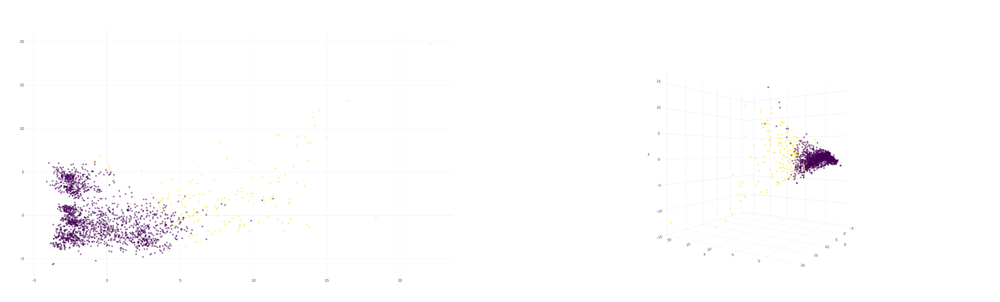

In [190]:
col = np.where(data_np[:, -1] > 7, 1, 0)
plot_tsne(pca_2d, pca_3d, col)

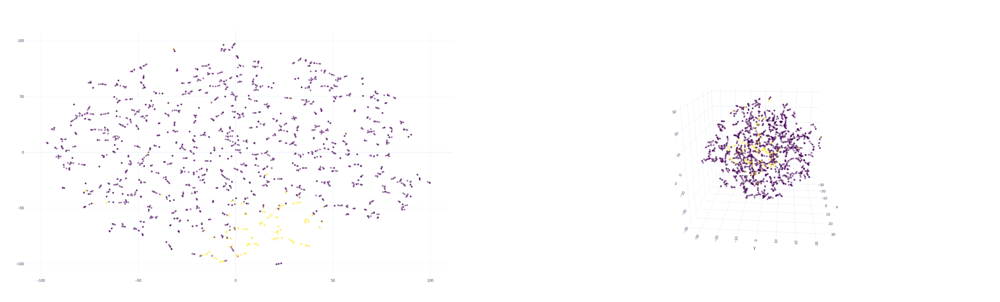

In [189]:
plot_tsne(tsne_2d, tsne_3d, col)

In [ ]:
data.isna().sum(axis=0)

In [66]:
db_2d = KMeans(n_clusters=15).fit(data_np)
data["cluster"] = db_2d.labels_

/home/l727r/anaconda3/envs/data_viz/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [ ]:
cid = 19
files = data[data["cluster"] == cid]
for f in files["file_name"]:
    print(f"'{f}',")

In [54]:
X_2d = TSNE(
    n_components=2, learning_rate="auto", init="random", perplexity=3
).fit_transform(data_np[:, :])
# db_2d = DBSCAN(eps=5, min_samples=5).fit(X_2d)
db_2d = KMeans(n_clsuters=15).fit(data_np)
print(len(np.unique(db_2d.labels_)))

TypeError: KMeans.__init__() got an unexpected keyword argument 'n_clsuters'

In [38]:
data["cluster"] = db_2d.labels_

In [69]:
# cid=1
# data["cluster"]=db_2d.labels_
# files=data[data["cluster"]==cid]
# for f in files["file_name"]:
#     print(f"'{f}',")

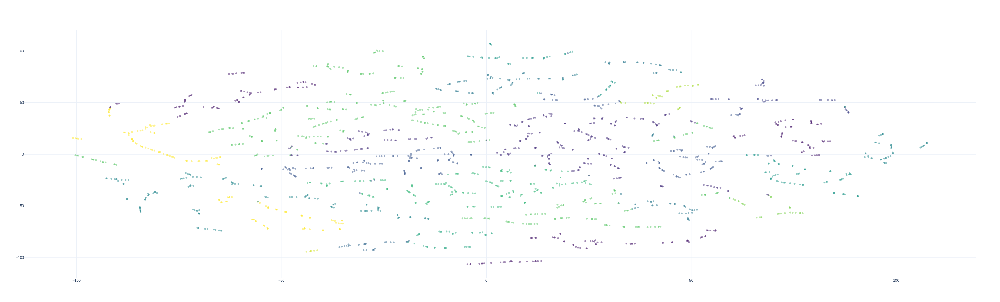

In [67]:
fig = make_subplots(rows=1, cols=1)
fig.update_layout(height=1000, width=1000, showlegend=False, template="plotly_white")

fig.add_trace(
    go.Scatter(
        x=X_2d[:, 0],
        y=X_2d[:, 1],
        mode="markers",
        hovertext=db_2d.labels_,
        marker=dict(
            opacity=0.5,
            cmin=-1,
            cmax=np.max(db_2d.labels_),
            color=db_2d.labels_,
            colorscale="Viridis",
        ),
    ),
    row=1,
    col=1,
)  # hover text goes here
# fig.add_trace(go.Scatter3d(x=X_3d[:,0],y=X_3d[:,1],z=X_3d[:,2],mode='markers',hovertext=db_2d.labels_,marker=dict(size=3,opacity=0.5,cmin=-1,cmax=np.max(db_3d.labels_),color=db_3d.labels_,colorscale="Viridis")),row=1,col=2) # hover text goes here

fig.show()

In [261]:
def get_outliers(df, prop):
    q1 = df[prop].quantile(q=0.25)
    q3 = df[prop].quantile(q=0.75)
    iqr = q3 - q1
    upper = q3 + 1.5 * iqr
    lower = q1 - 1.5 * iqr

    out = df.loc[(df[prop] > upper) | (df[prop] < lower)]
    # out=out.loc[out[prop] < lower ]
    return out

In [262]:
outliers = []
for col in data.columns:
    if col in ["Unnamed: 0", "file_name"]:
        continue
    out = get_outliers(data, col)
    outliers += out["file_name"].values.tolist()

In [263]:
outliers = []
for col in data.columns:
    if col in ["Unnamed: 0", "file_name"]:
        continue
    out = get_outliers(data, col)
    outliers += out["file_name"].values.tolist()

un, cou = np.unique(outliers, return_counts=True)
outliers_count = zip(cou, un)
outliers_count = sorted(outliers_count, reverse=True)
data["out_count"] = 0
for x in outliers_count:
    data.loc[data["file_name"] == x[1], "out_count"] = [x[0]]
data.head()

,file_name,mesh__edges__count,mesh__edges__mean_length,mesh__edges__std_length,mesh__triangles__mean_size,mesh__triangles__std_size,mesh__triangles__mean_regularity,mesh__triangles__std_regularity,all_pores__area__covered,all_pores__instances__count,...,internal_structure__instances__std_size,artifact_blob__area__covered,artifact_blob__instances__count,artifact_blob__instances__mean_size,artifact_blob__instances__std_size,artifact_dust__area__covered,artifact_dust__instances__count,artifact_dust__instances__mean_size,artifact_dust__instances__std_size,out_count
0,S16046_112a_PS83-P4VP17-88k_OS_001.png,1179,106.900619,67.206045,4107.340186,3602.427576,0.563282,0.171408,35883.883732,410,...,NaN,0.000000,0,NaN,NaN,0.0,0,NaN,NaN,5
1,S16046_112a_PS83-P4VP17-88k_OS_002.png,8,814.603709,274.575082,170400.925926,126936.712297,0.456518,0.280228,58.971050,5,...,NaN,2232.098765,5,90.4,142.523823,0.0,0,NaN,NaN,11
2,S16046_112c_PS83-P4VP17-88k_OS_C-Tab_001.png,0,NaN,NaN,NaN,NaN,NaN,NaN,76.662365,2,...,NaN,1901.234568,1,385.0,0.000000,0.0,0,NaN,NaN,6
3,S16244_26%_PS75P4VP25_100k_13s_50DMF_50THF_003...,2162,71.338964,46.417328,2244.367732,3307.145341,0.716088,0.186436,497220.302508,757,...,691.800257,0.000000,0,NaN,NaN,0.0,0,NaN,NaN,9
4,S16244_26%_PS75P4VP25_100k_5s_50DMF_50THF_006.png,2861,63.375359,33.711659,1710.521498,2330.481354,0.769491,0.179288,583040.871112,996,...,458.156026,0.000000,0,NaN,NaN,0.0,0,NaN,NaN,5


In [264]:
data_np = np.array(data.values.tolist())[:, 1:]
data_np = np.array(data_np, dtype=float)
data_np.shape
data_np = np.nan_to_num(data_np, nan=0)
data_np[:, :-1].shape
np.unique(data_np[:, -1])

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 22.])

124


In [265]:
def PCA_plot_2(df):
    X_2d = PCA(n_components=2).fit_transform(df[:, :-1])
    X_3d = PCA(n_components=3).fit_transform(df[:, :-1])

    fig = make_subplots(
        rows=1, cols=2, specs=[[{"type": "Scatter"}, {"type": "Scatter3d"}]]
    )

    fig.update_layout(
        height=1000, width=2000, showlegend=False, template="plotly_white"
    )

    # fig.add_trace(go.Scatter(x=X_2d[:,0],y=X_2d[:,1],mode='markers',marker=dict(opacity=1,cmin=0,cmax=5,color=np.random.randint(0,5,1970),colorscale="Viridis",colorbar=dict( title="Colorbar" ),)),row=1,col=1) # hover text goes here
    fig.add_trace(
        go.Scatter(
            x=X_2d[:, 0],
            y=X_2d[:, 1],
            mode="markers",
            marker=dict(
                opacity=0.5, cmin=0, cmax=22, color=df[:, -1], colorscale="Viridis"
            ),
        ),
        row=1,
        col=1,
    )  # hover text goes here
    fig.add_trace(
        go.Scatter3d(
            x=X_3d[:, 0],
            y=X_3d[:, 1],
            z=X_3d[:, 2],
            mode="markers",
            marker=dict(
                size=1,
                opacity=0.5,
                cmin=0,
                cmax=22,
                color=df[:, -1],
                colorscale="Viridis",
            ),
        ),
        row=1,
        col=2,
    )  # hover text goes here
    print(df[:, -1])
    fig.show()

In [62]:
def TSNE_plot_3(df):
    X_2d = TSNE(
        n_components=2, learning_rate="auto", init="random", perplexity=3
    ).fit_transform(df)
    X_3d = TSNE(
        n_components=3, learning_rate="auto", init="random", perplexity=3
    ).fit_transform(df)

    # db_2d = DBSCAN(eps=5, min_samples=5).fit(X_2d)
    db_2d = KMeans(n_clusters=10).fit(df)
    print("2D clsuter", len(np.unique(db_2d.labels_)))

    # thresh=5
    # clusters_3d = hcluster.fclusterdata(X_3d, thresh, criterion="distance")
    # db_3d = DBSCAN(eps=5, min_samples=5).fit(X_3d)
    db_3d = db_2d  # KMeans(n_clusters=10).fit(df)
    print("3D clsuter", len(np.unique(db_3d.labels_)))
    fig = make_subplots(
        rows=1, cols=2, specs=[[{"type": "Scatter"}, {"type": "Scatter3d"}]]
    )

    fig.update_layout(
        height=1000, width=2000, showlegend=False, template="plotly_white"
    )

    fig.add_trace(
        go.Scatter(
            x=X_2d[:, 0],
            y=X_2d[:, 1],
            mode="markers",
            hovertext=db_2d.labels_,
            marker=dict(
                opacity=0.5,
                cmin=-1,
                cmax=np.max(db_2d.labels_),
                color=db_2d.labels_,
                colorscale="Viridis",
            ),
        ),
        row=1,
        col=1,
    )  # hover text goes here
    fig.add_trace(
        go.Scatter3d(
            x=X_3d[:, 0],
            y=X_3d[:, 1],
            z=X_3d[:, 2],
            mode="markers",
            hovertext=db_2d.labels_,
            marker=dict(
                size=3,
                opacity=0.5,
                cmin=-1,
                cmax=np.max(db_3d.labels_),
                color=db_3d.labels_,
                colorscale="Viridis",
            ),
        ),
        row=1,
        col=2,
    )  # hover text goes here

    fig.show()

In [230]:
def TSNE_plot_2(df):
    X_2d = TSNE(
        n_components=2, learning_rate="auto", init="random", perplexity=3
    ).fit_transform(df[:, :-1])
    X_3d = TSNE(
        n_components=3, learning_rate="auto", init="random", perplexity=3
    ).fit_transform(df[:, :-1])

    fig = make_subplots(
        rows=1, cols=2, specs=[[{"type": "Scatter"}, {"type": "Scatter3d"}]]
    )

    fig.update_layout(
        height=1000, width=2000, showlegend=False, template="plotly_white"
    )

    fig.add_trace(
        go.Scatter(
            x=X_2d[:, 0],
            y=X_2d[:, 1],
            mode="markers",
            marker=dict(
                opacity=0.5, cmin=0, cmax=22, color=df[:, -1], colorscale="Viridis"
            ),
        ),
        row=1,
        col=1,
    )  # hover text goes here
    fig.add_trace(
        go.Scatter3d(
            x=X_3d[:, 0],
            y=X_3d[:, 1],
            z=X_3d[:, 2],
            mode="markers",
            marker=dict(
                size=1,
                opacity=0.5,
                cmin=0,
                cmax=22,
                color=df[:, -1],
                colorscale="Viridis",
            ),
        ),
        row=1,
        col=2,
    )  # hover text goes here

    fig.show()

[5. 9. 5. ... 2. 4. 3.]


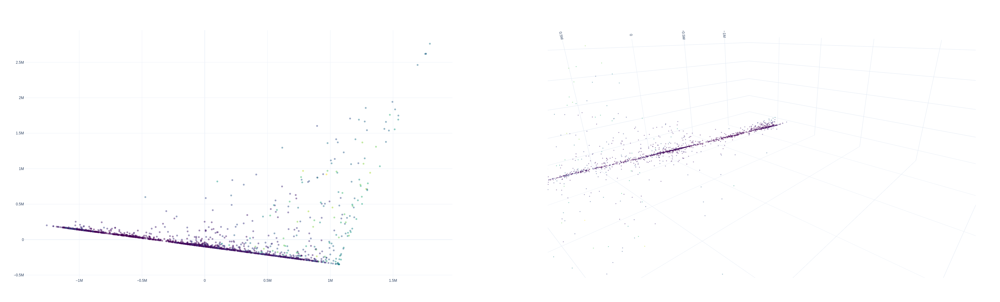

In [231]:
PCA_plot_2(data_np)

2D clsuter 10
3D clsuter 10


/home/l727r/anaconda3/envs/data_viz/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/home/l727r/anaconda3/envs/data_viz/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



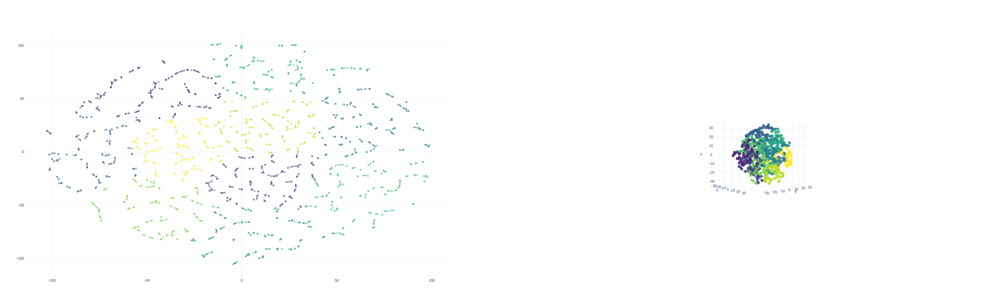

In [61]:
TSNE_plot_3(data_np)

/home/l727r/anaconda3/envs/data_viz/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



2D clsuter 10
3D clsuter 10


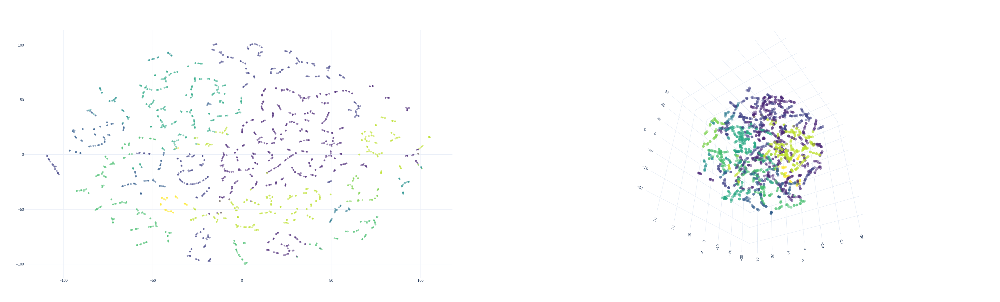

In [63]:
TSNE_plot_3(data_np)

In [77]:
def TSNE_plot(df):
    X_2d = TSNE(
        n_components=2, learning_rate="auto", init="random", perplexity=3
    ).fit_transform(df)
    X_3d = TSNE(
        n_components=3, learning_rate="auto", init="random", perplexity=3
    ).fit_transform(df)

    fig = make_subplots(
        rows=1, cols=2, specs=[[{"type": "Scatter"}, {"type": "Scatter3d"}]]
    )

    fig.update_layout(
        height=1000, width=2000, showlegend=False, template="plotly_white"
    )

    fig.add_trace(
        go.Scatter(
            x=X_2d[:, 0], y=X_2d[:, 1], mode="markers", marker=dict(opacity=0.2)
        ),
        row=1,
        col=1,
    )  # hover text goes here
    fig.add_trace(
        go.Scatter3d(
            x=X_3d[:, 0],
            y=X_3d[:, 1],
            z=X_3d[:, 2],
            mode="markers",
            marker=dict(opacity=0.2),
        ),
        row=1,
        col=2,
    )  # hover text goes here

    fig.show()

In [81]:
def PCA_plot(df):
    X_2d = PCA(n_components=2).fit_transform(df)
    X_3d = PCA(n_components=3).fit_transform(df)

    fig = make_subplots(
        rows=1, cols=2, specs=[[{"type": "Scatter"}, {"type": "Scatter3d"}]]
    )

    fig.update_layout(
        height=1000, width=2000, showlegend=False, template="plotly_white"
    )

    fig.add_trace(
        go.Scatter(
            x=X_2d[:, 0], y=X_2d[:, 1], mode="markers", marker=dict(opacity=0.2)
        ),
        row=1,
        col=1,
    )  # hover text goes here
    fig.add_trace(
        go.Scatter3d(
            x=X_3d[:, 0],
            y=X_3d[:, 1],
            z=X_3d[:, 2],
            mode="markers",
            marker=dict(opacity=0.2),
        ),
        row=1,
        col=2,
    )  # hover text goes here

    fig.show()

In [86]:
def PCA_TSNE_plot(df):
    X_pca = PCA(n_components=20).fit_transform(df)
    X_2d = TSNE(
        n_components=2, learning_rate="auto", init="random", perplexity=3
    ).fit_transform(X_pca)
    X_3d = TSNE(
        n_components=3, learning_rate="auto", init="random", perplexity=3
    ).fit_transform(X_pca)

    fig = make_subplots(
        rows=1, cols=2, specs=[[{"type": "Scatter"}, {"type": "Scatter3d"}]]
    )

    fig.update_layout(
        height=1000, width=2000, showlegend=False, template="plotly_white"
    )

    fig.add_trace(
        go.Scatter(
            x=X_2d[:, 0], y=X_2d[:, 1], mode="markers", marker=dict(opacity=0.2)
        ),
        row=1,
        col=1,
    )  # hover text goes here
    fig.add_trace(
        go.Scatter3d(
            x=X_3d[:, 0],
            y=X_3d[:, 1],
            z=X_3d[:, 2],
            mode="markers",
            marker=dict(opacity=0.2),
        ),
        row=1,
        col=2,
    )  # hover text goes here

    fig.show()

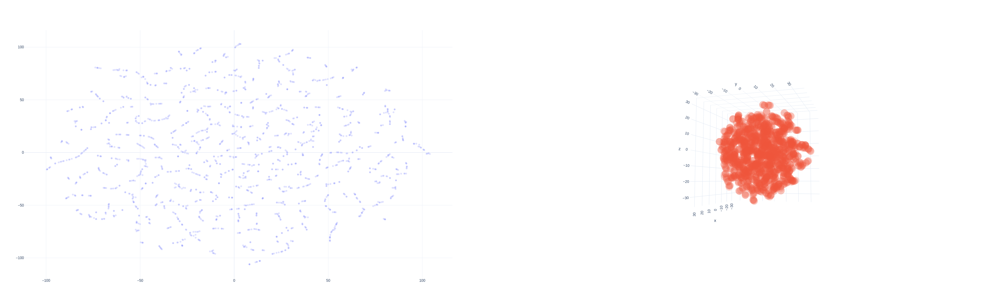

In [87]:
PCA_TSNE_plot(data_np)

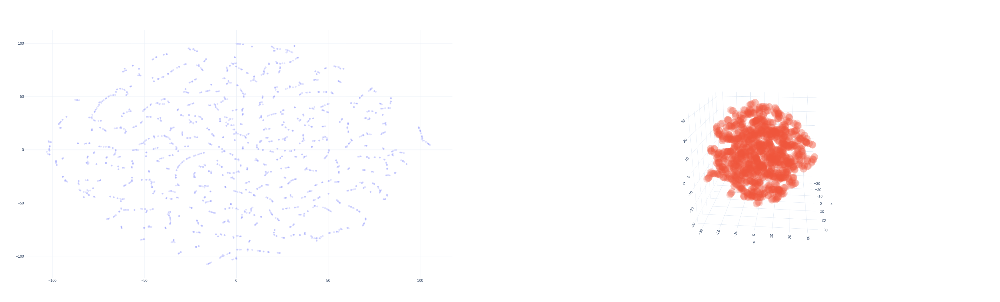

In [78]:
TSNE_plot(data_np)

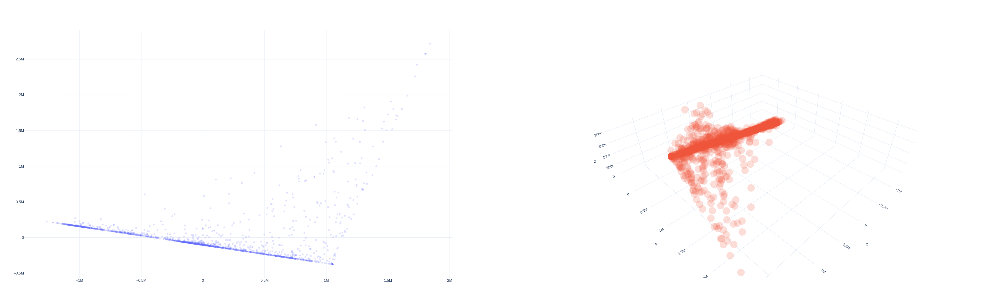

In [80]:
PCA_plot(data_np)